In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Read OTUS.99 info

*	here we can find the otus, the code, representative read and the taxonomi

In [2]:
file_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/otus.99.allinfo"

# Read and display the first 20 lines for inspection
with open(file_path, "r") as file:
    for i in range(50):
        print(file.readline().strip())  

MAPv3;90_1331;96_6200;97_7452;98_46017;99_90652	2					GCTTAATACATGCAAGTCGAACGCGAAAGGGGCTTCGGCCCTGAGTAGAGTGGCGTCCGGGTGAGTAACGCGTGGGTAATCTACCTTCGGGTGGGGAATAACCAGTCGAAAGGCTGGCTAATACCGCATAATGCAGCGGCACGACATCGTGACAGTTGTTAAAGGAGCAATCCGCCTGAAGAGGAGCCTGCGTCTGATTAGCTTGTTGGTGAGGTAATGGCTCACCAAGGCTGCGATCAGTAGCTGGTCTGAGAGGACGGCCAGCCACAATGGCACTGAAACACGGGCCATACTCCTACGGGAGGCAGCAGTGGGGAATTTTGCGCAATGGGCGAAAGCCTGACGCAGCAACGCCGCGTGAAGGATGAAATCCTTCGGGATGTAAACTTCGCAAATCTGGGAAGAACATAATGACGGTACCAGATGTAAGCCACGGCTAACTCTGTGCCAGCAGCCGCGGTAATACAGAGGTGGCAAGCGTTGTTCGGAATTACTGGGCGTAAAGCGCGTGTAGGCGGCTCTTCAAGTCAGGCGTGAAAGCCCCAGGCTCAACCTGGGAAATGCGTTTGATACTGTCGAGCTAGAGTGTGGAAGGGGCGATTGGAATTCCGTGTGTAGCGGTGAAATGCGTAGATATACGGAGGAACACCAGAGGCGAAGGCGGATCGCTGGGCCAACACTGACGCTGAGACGCGAAAGCTAGGGTAGCAAACGGGATTAGATACCCCGGTAGTCCTAGCCTTAAACGATGCTGACTTGGTGTCCCCGGTTTTAAGTCCGGGGGTGTCGGAGCTAACGCGTTAAGTCAGCCGCCTGGGGAGTACGGTCGCAAGGCTGAAACTCAAAGGAATTGACGGGGACCCGCACAAGCGGTGGAGCATGTGGTTTAATTCGACGCAACGCGAAGAACCTTACCTGGGCTAGAATGCGGTGGATAAGCTGTAGA

In [ ]:
# Define file path
file_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/otus.99.allinfo"

# Initialize list to store extracted data
otu_data = []

# Read and process the file line by line
with open(file_path, "r") as file:
    for line in file:
        parts = line.strip().split("\t")  # Split by tab
        
        if len(parts) < 3:
            continue  # Skip lines that don't have enough information

        # Extract key information with index validation
        otu_id_full = parts[0]  # Full OTU Identifier (e.g., "MAPv3;90_xxx;96_xxx;...")
        otu_id = otu_id_full.replace("MAPv3;", "")  # Remove "MAPv3;"
        
        count = parts[1] if len(parts) > 1 else None  # Count or missing        
		# save the reads 
        read = parts[6] if len(parts) > 8 else None
        # Extract taxonomy-related information
        taxonomy = parts[8] if len(parts) > 8 else None  # d__Bacteria...
        alternative_taxonomy = parts[14] if len(parts) > 14 else None  # More detailed classification
        
        ncbi_ref_id = parts[7] if len(parts) > 7 else None  # AY520230:1..1740
        ref_genome = parts[10] if len(parts) > 10 else None  # RS_GCF_000508925.1~NZ_BAHT02000264.1
        accession_id = parts[16] if len(parts) > 16 else None  # AB018123:1..1765
        
        # Handle possible float conversion errors in confidence scores
        try:
            confidence_score = float(parts[12]) if len(parts) > 12 and parts[12].replace('.', '', 1).isdigit() else None
        except ValueError:
            confidence_score = None  # Assign None if conversion fails
        
        try:
            read_count = int(parts[13]) if len(parts) > 13 and parts[13].isdigit() else None
        except ValueError:
            read_count = None  # Assign None if conversion fails
        
        try:
            sec_confidence_score = float(parts[18]) if len(parts) > 18 and parts[18].replace('.', '', 1).isdigit() else None
        except ValueError:
            sec_confidence_score = None
        
        try:
            sec_read_count = int(parts[19]) if len(parts) > 19 and parts[19].isdigit() else None
        except ValueError:
            sec_read_count = None
        
        # Store in list
        otu_data.append({
            "otu_id": otu_id,  # Store cleaned OTU ID
            "count": count,
            "read": read,
            "taxonomy": taxonomy,
            "alt_taxonomy": alternative_taxonomy,
            "ref_id": ncbi_ref_id,
            "ref_genome": ref_genome,
            "accession_id": accession_id,
            "confidence_score": confidence_score,
            "read_count": read_count,
            "sec_confidence_score": sec_confidence_score,
            "sec_read_count": sec_read_count
        })  
        
df_otus = pd.DataFrame(otu_data)

display(df_otus.head(20))
output_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/preprosses_data/processed_otus_info_99.csv"
df_otus.to_csv(output_path, index=False)

print(f"Processed OTU data saved to: {output_path}")

,otu_id,count,read,taxonomy,alt_taxonomy,ncbi_ref_id,ref_genome,accession_id,confidence_score,read_count,sec_confidence_score,sec_read_count
0,90_1331;96_6200;97_7452;98_46017;99_90652,2,GCTTAATACATGCAAGTCGAACGCGAAAGGGGCTTCGGCCCTGAGT...,d__Bacteria;p__Acidobacteriota;c__Blastocatell...,Bacteria;Acidobacteria;Blastocatellia,JF265871:1..1344,GB_GCA_003222245.1~QHVH01000001.1,NC_016024:103114..104617,0.858798,942,0.812454,787
1,90_15782;96_6806;97_8149;98_9996;99_120474,1,CGGGTGCGTAACACGTGAGAAACCTGCCCCGGTCTCTGGGATAACA...,d__Bacteria;p__Actinobacteriota;c__Acidimicrob...,Bacteria;Actinobacteria;Acidimicrobiia;Acidimi...,KC358213:1..1308,RS_GCF_000350145.1~NZ_BAOL01000001.1,NC_020520:2930699..2932226,0.941131,1149,0.931957,1125
2,90_18593;96_74510;97_96468;98_130600;99_199293,3,AAGATTAAGCCATGCATGTCTAAGTATAAGCATCTATACAGTGAAA...,d__Bacteria,Eukaryota;Ascomycota;Saccharomycetes;Saccharom...,AY520173:1..1684,RS_GCF_003006845.1~NZ_PXMA01000065.1,AB018123:1..1765,0.917031,191,0.975518,995
3,90_1368;96_28107;97_35403;98_45723;99_64686,1,ATGAACGCTAGCTACAGGCTTAACACATGCAAGTCGCGGGGCAGCA...,d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__...,Bacteria;Bacteroidetes;Bacteroidia;Bacteroidal...,GU198354:1..1488,RS_GCF_002251535.1~NZ_NPJD01000018.1,NC_014033:223907..225439,0.893145,1155,0.886348,1139
4,90_18;96_298;97_4511;98_47806;99_67852,1,GCGGACGGGTGAGTAATGCTTGGGAATCTGGCTTATGGAGGGGGAT...,d__Bacteria;p__Proteobacteria;c__Gammaproteoba...,Bacteria;Proteobacteria;Gammaproteobacteria;Pa...,HQ717327:1..1300,RS_GCF_000973525.1~NZ_CP004391.1-#4,M75050:1..1479,0.984604,1254,0.976905,1234
5,90_18601;96_72591;97_95718;98_129740;99_198266,1,TGTCTCAAAGATTAAGCCATGCATGTCTCAGTACAAGCCGAATTAA...,d__Bacteria,Eukaryota;Chordata;Actinopteri;Cyprinodontiformes,KF625733:1..1854,RS_GCF_003234935.1~NZ_QKSB01000048.1,NC_036464:25462737..25464659,0.951009,308,0.866221,207
6,90_773;96_4924;97_5965;98_7473;99_19556,13,AGAGTTTGATCCTGGCTCAGGACGAACGCTGGCGGCGCGCTTAACA...,d__Bacteria;p__Actinobacteriota;c__Thermoleoph...,Bacteria;Actinobacteria;Thermoleophilia;Soliru...,JF169062:1..1366,GB_GCA_003132585.1~PKYG01000014.1,NZ_AUIK01000022:104737..106285,0.882275,1141,0.879709,1124
7,90_422;96_1935;97_2327;98_9474;99_99426,1,GAGTTTGATTATGGCAAAGAACGTAGGCTGGGGGACTGGGCTAAGG...,d__Bacteria;p__Proteobacteria;c__Alphaproteoba...,Bacteria;Proteobacteria;Alphaproteobacteria;Pe...,KF596545:1..1445,GB_GCA_000750175.1~JPLS01000097.1,NC_015380:109477..110971,0.976625,1305,0.957633,1253
8,90_1777;96_26538;97_33322;98_42823;99_60320,1,TCAGAACGAACGCTGGCGGCAGGCCTGAGGCATGCAAGTCGAACGA...,d__Bacteria;p__Proteobacteria;c__Alphaproteoba...,Bacteria;Proteobacteria;Alphaproteobacteria;Rh...,JN468856:1..1411,GB_GCA_900472055.1~UCGO01000088.1,NC_016078:2873081..2874572,0.826364,884,0.835461,906
9,90_16;96_45268;97_58057;98_77014;99_113745,1,GAGTTTGATCCTGGCTCAGGATGAACGCTGGCGGCGTGCTTAACAC...,d__Bacteria;p__Firmicutes_A;c__Clostridia;o__L...,Bacteria;Firmicutes;Clostridia;Clostridiales;L...,DQ797199:1..1390,RS_GCF_001405295.1~NZ_CZAJ01000038.1,AB626630:1..1494,0.939612,1214,0.939612,1214


Processed OTU data saved to: /home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/preprosses_data/processed_otus_info.csv


In [4]:
df_otus.shape

(225066, 11)

# samples.info

In [8]:
N_SAMPLES = 10  # Adjust this number to load more or fewer samples
file_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/samples.info"



samples = []
current_sample = {}
sample_count = 0

# Read file line by line
with open(file_path, "r") as file:
    for line in file:
        line = line.strip()

        if line.startswith(">"):  # New sample ID
            if current_sample:  # Store previous sample
                samples.append(current_sample)
                sample_count += 1
                if sample_count >= N_SAMPLES:
                    break  # Stop after loading N samples
            current_sample = {"sample_id": line[1:]}  # Remove ">" and start new entry
        
        elif "=" in line:  # Key-value pairs
            key, value = line.split("=", 1)  # Split at the first '='
            current_sample[key.strip()] = value.strip()

    if current_sample and sample_count < N_SAMPLES:  # Store last sample if needed
        samples.append(current_sample)

df_samples = pd.DataFrame(samples)
display(df_samples.head(10))

,sample_id,sample_center_name,sample_alias,sample_TAXON_ID,sample_SCIENTIFIC_NAME,sample_DESCRIPTION,sample_XREF_LINK,sample_isolation_source,sample_collection_date,sample_geo_loc_name,...,sample_INSDC first public,sample_INSDC last update,sample_INSDC status,sample_SRA accession,sample_Sample Name,sample_Submitter Id,sample_common name,sample_phenotype,sample_subject id,sample_title
0,SRS7471636,,AOA_enrichment_SS,2109671,Candidatus Nitrosocosmicus sp.,Ca. nitrosocosmics,bioproject: 667025),ammonia-oxidizing archaea enrichment inoculate...,2018-12-01,China: Guangzhou,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,ERS2697201,Wellcome Sanger Institute,243d7ba2-8f1b-11e8-ae47-68b59976a384,749906,gut metagenome,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,ERS2756264,Wellcome Sanger Institute,d918ac14-bfd0-11e8-b114-68b59976a384,646099,human metagenome,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,SRS1490022,,F_baseline,408170,human gut metagenome,NaN,NaN,feces,2012-10-05,"USA: Lincoln, Nebraska",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,SRS723374,,125799208,646099,human metagenome,NaN,NaN,stool,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,SRS2517867,,S150,1592332,sludge metagenome,NaN,bioproject: 387345),CSTR,2016-01-10,missing,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,ERS3462421,,SAMEA5658398,9606,Homo sapiens,NaN,NaN,NaN,NaN,NaN,...,2020-09-09T17:06:25Z,2019-05-24T12:16:46Z,public,ERS3462421,98defe20-7e0f-11e9-83ef-68b59976a384,98defe20-7e0f-11e9-83ef-68b59976a384,human,Not supplied,Human_colon_16S7943231,Human
7,SRS5092595,,Limestone-lined channel 16S,410659,mine drainage metagenome,NaN,bioproject: 554371),acid mine drainage site biofilm from limestone...,Mar-2017,"USA: Daniel Boone National Forest, KY",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,SRS5092596,,Rose Pool 16S,410659,mine drainage metagenome,NaN,bioproject: 554371),acid mine drainage site biofilm from Rose Pool...,Mar-2017,"USA: Daniel Boone National Forest, KY",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,SRS5092597,,Emergence,410659,mine drainage metagenome,NaN,bioproject: 554371),Acid mine drainage site biofilm from emergence,Mar-2017,"USA: Daniel Boone National Forest, KY",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [47]:
df_samples.shape

(10, 2)

# Read Samples-otus

In [8]:
file_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/samples-otus.99.mapped"

# Read the first 20 lines
with open(file_path, 'r') as file:
    for i in range(20):
        print(file.readline().strip())

>SRR2459896.SRS1074972	66481	15322	397
90_15828;96_741;97_864;98_1008;99_1277	4478
90_246;96_8626;97_10374;98_12724;99_16815	2667
90_3;96_530;97_6036;98_7555;99_10160	1215
90_1349;96_5812;97_6987;98_8642;99_11535	1114
90_2004;96_8630;97_10378;98_12728;99_150148	829
90_5;96_8632;97_10380;98_12730;99_16821	702
90_207;96_8631;97_10379;98_12729;99_16820	364
90_196;96_13782;97_18927;98_23599;99_31786	299
90_17;96_14843;97_18125;98_22544;99_30298	236
90_34;96_226;97_248;98_277;99_324	217
90_1043;96_25689;97_36142;98_46736;99_141665	159
90_6204;96_27515;97_34620;98_44640;99_63061	143
90_1043;96_25689;97_36142;98_46736;99_66232	141
90_16009;96_67222;97_87325;98_118691;99_182148	141
90_16617;96_5810;97_6985;98_8640;99_11532	116
90_34;96_226;97_248;98_277;99_6861	105
90_246;96_941;97_1095;98_1306;99_1650	92
90_3;96_530;97_611;98_702;99_890	84
90_196;96_675;97_781;98_905;99_1153	73


In [9]:
# Read only the first 100 rows if it's a CSV or TSV file
df = pd.read_csv(file_path, sep='\t', nrows=100)  # Change `sep` accordingly
df.head()


,>SRR2459896.SRS1074972,66481,15322,397
0,90_15828;96_741;97_864;98_1008;99_1277,4478,NaN,NaN
1,90_246;96_8626;97_10374;98_12724;99_16815,2667,NaN,NaN
2,90_3;96_530;97_6036;98_7555;99_10160,1215,NaN,NaN
3,90_1349;96_5812;97_6987;98_8642;99_11535,1114,NaN,NaN
4,90_2004;96_8630;97_10378;98_12728;99_150148,829,NaN,NaN


In [10]:
file_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/samples-otus.99.mapped"

with open(file_path, "r") as file:
    lines = file.readlines()

# Process the first 20 lines for readability
for i in range(min(20, len(lines))):
    line = lines[i].strip()
    
    if line.startswith(">"):  
        # Sample header (e.g., ">SRR2459896.SRS1074972")
        print(f"\nSample: {line[1:]}\n" + "-"*50)
    else:
        # Split OTU abundance data (assuming space-separated values)
        otu_data = line.split()
        formatted_otu = [entry.replace("_", ":") for entry in otu_data]  # Replace "_" with ":" for clarity
        print(", ".join(formatted_otu))  # Print formatted OTU data



Sample: SRR2459896.SRS1074972	66481	15322	397
--------------------------------------------------
90:15828;96:741;97:864;98:1008;99:1277, 4478
90:246;96:8626;97:10374;98:12724;99:16815, 2667
90:3;96:530;97:6036;98:7555;99:10160, 1215
90:1349;96:5812;97:6987;98:8642;99:11535, 1114
90:2004;96:8630;97:10378;98:12728;99:150148, 829
90:5;96:8632;97:10380;98:12730;99:16821, 702
90:207;96:8631;97:10379;98:12729;99:16820, 364
90:196;96:13782;97:18927;98:23599;99:31786, 299
90:17;96:14843;97:18125;98:22544;99:30298, 236
90:34;96:226;97:248;98:277;99:324, 217
90:1043;96:25689;97:36142;98:46736;99:141665, 159
90:6204;96:27515;97:34620;98:44640;99:63061, 143
90:1043;96:25689;97:36142;98:46736;99:66232, 141
90:16009;96:67222;97:87325;98:118691;99:182148, 141
90:16617;96:5810;97:6985;98:8640;99:11532, 116
90:34;96:226;97:248;98:277;99:6861, 105
90:246;96:941;97:1095;98:1306;99:1650, 92
90:3;96:530;97:611;98:702;99:890, 84
90:196;96:675;97:781;98:905;99:1153, 73


In [24]:
file_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/samples-otus.99.metag.minfilter"

with open(file_path, "r") as file:
    lines = file.readlines()

# Process the first 20 lines for readability
for i in range(min(20, len(lines))):
    line = lines[i].strip()
    
    if line.startswith(">"):  
        # Sample header (e.g., ">SRR2459896.SRS1074972")
        print(f"\nSample: {line[1:]}\n" + "-"*50)
    else:
        # Split OTU abundance data (assuming space-separated values)
        otu_data = line.split()
        formatted_otu = [entry.replace("_", ":") for entry in otu_data]  # Replace "_" with ":" for clarity
        print(", ".join(formatted_otu))  # Print formatted OTU data



Sample: SRR2459896.SRS1074972	66481	15322	397
--------------------------------------------------
90:15828;96:741;97:864;98:1008;99:1277, 4478
90:246;96:8626;97:10374;98:12724;99:16815, 2667
90:3;96:530;97:6036;98:7555;99:10160, 1215
90:1349;96:5812;97:6987;98:8642;99:11535, 1114
90:2004;96:8630;97:10378;98:12728;99:150148, 829
90:5;96:8632;97:10380;98:12730;99:16821, 702
90:207;96:8631;97:10379;98:12729;99:16820, 364
90:196;96:13782;97:18927;98:23599;99:31786, 299
90:17;96:14843;97:18125;98:22544;99:30298, 236
90:34;96:226;97:248;98:277;99:324, 217
90:1043;96:25689;97:36142;98:46736;99:141665, 159
90:6204;96:27515;97:34620;98:44640;99:63061, 143
90:1043;96:25689;97:36142;98:46736;99:66232, 141
90:16009;96:67222;97:87325;98:118691;99:182148, 141
90:16617;96:5810;97:6985;98:8640;99:11532, 116
90:34;96:226;97:248;98:277;99:6861, 105
90:246;96:941;97:1095;98:1306;99:1650, 92
90:3;96:530;97:611;98:702;99:890, 84
90:196;96:675;97:781;98:905;99:1153, 73


# Count number of samples, (testing parallele functions)

In [3]:
from multiprocessing import Pool


In [4]:
file_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/samples-otus.97.metag.minfilter"

def count_samples_in_chunk(chunk):
    """Count the number of sample headers '>' in a chunk of the file."""
    return sum(1 for line in chunk if line.startswith(">"))

def count_samples_parallel(file_path, num_workers=4, chunk_size=10**6):
    """Count the number of samples in a large file using parallel processing."""
    total_samples = 0
    with open(file_path, "r") as file:
        with Pool(processes=num_workers) as pool:
            while True:
                chunk = file.readlines(chunk_size)  # Read a chunk of lines
                if not chunk:
                    break
                results = pool.map(count_samples_in_chunk, [chunk])
                total_samples += sum(results)
    
    return total_samples

# Run the counting process
num_samples = count_samples_parallel(file_path, num_workers=20) 
print(f"Total number of samples: {num_samples}")

Total number of samples: 1836255


# study metadata (labels)

In [9]:
from collections import Counter


In [11]:

file_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/samples.info"
NUM_WORKERS = 30  # Adjust based on CPU cores
CHUNK_SIZE = 10**6  # Read file in chunks (adjust as needed)

def process_chunk(lines):
    """Function to process a chunk and count occurrences of `sample_SCIENTIFIC_NAME`."""
    local_counter = Counter()
    current_sample = {}

    for line in lines:
        line = line.strip()
        if line.startswith(">"):  # New sample
            if "sample_SCIENTIFIC_NAME" in current_sample:
                local_counter[current_sample["sample_SCIENTIFIC_NAME"]] += 1
            current_sample = {}  # Reset for new sample

        elif "=" in line:  # Key-value pairs
            key, value = line.split("=", 1)
            if key.strip() == "sample_SCIENTIFIC_NAME":
                current_sample[key.strip()] = value.strip()

    # Add the last processed sample
    if "sample_SCIENTIFIC_NAME" in current_sample:
        local_counter[current_sample["sample_SCIENTIFIC_NAME"]] += 1

    return local_counter

def count_scientific_names_parallel(file_path, num_workers=NUM_WORKERS):
    """Reads a large file in parallel and counts occurrences of `sample_SCIENTIFIC_NAME`."""
    total_counter = Counter()

    with open(file_path, "r") as file, Pool(processes=num_workers) as pool:
        while True:
            chunk = file.readlines(CHUNK_SIZE)  # Read in chunks
            if not chunk:
                break
            results = pool.map(process_chunk, [chunk])
            for res in results:
                total_counter.update(res)  # Merge results

    return total_counter

In [12]:
# Run parallel processing
scientific_name_counts = count_scientific_names_parallel(file_path)

# Convert Counter to DataFrame
df_scientific_counts = pd.DataFrame(scientific_name_counts.items(), columns=["Scientific Name", "Count"])

# Save as variable for future analysis
scientific_name_variable = df_scientific_counts

# Display first few results
display(df_scientific_counts.head())

# Save to CSV if needed
df_scientific_counts.to_csv("scientific_name_counts.csv", index=False)

,Scientific Name,Count
0,Candidatus Nitrosocosmicus sp.,1
1,gut metagenome,120042
2,human metagenome,112328
3,human gut metagenome,277878
4,sludge metagenome,6727


In [13]:
display(df_scientific_counts.head(20))


,Scientific Name,Count
0,Candidatus Nitrosocosmicus sp.,1
1,gut metagenome,120042
2,human metagenome,112328
3,human gut metagenome,277878
4,sludge metagenome,6727
5,Homo sapiens,60203
6,mine drainage metagenome,444
7,uncultured bacterium,16190
8,pig gut metagenome,22014
9,synthetic metagenome,7695


In [15]:
df_scientific_counts.shape

(16700, 2)

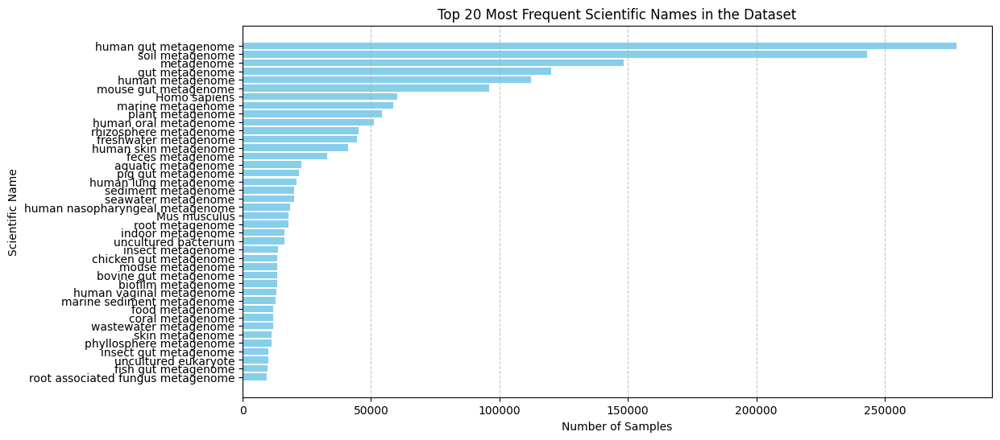

In [19]:

# Sort by count and take the top 20 most frequent scientific names
df_top_scientific = df_scientific_counts.sort_values(by="Count", ascending=False).head(40)

# Plot the histogram
plt.figure(figsize=(12, 6))
plt.barh(df_top_scientific["Scientific Name"], df_top_scientific["Count"], color="skyblue")
plt.xlabel("Number of Samples")
plt.ylabel("Scientific Name")
plt.title("Top 20 Most Frequent Scientific Names in the Dataset")
plt.gca().invert_yaxis()  # Invert Y-axis for better readability
plt.grid(axis="x", linestyle="--", alpha=0.7)

# Show plot
plt.show()

In [17]:
df_scientific_counts.sort_values(by="Count", ascending=False).head(40)

,Scientific Name,Count
3,human gut metagenome,277878
16,soil metagenome,243084
26,metagenome,148388
1,gut metagenome,120042
2,human metagenome,112328
21,mouse gut metagenome,95974
5,Homo sapiens,60203
28,marine metagenome,58657
76,plant metagenome,54308
56,human oral metagenome,50980


# reSave dataset with taxa names

In [10]:
import csv
import multiprocessing


In [4]:
# Paths
otu_info_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/preprosses_data/processed_otus_info.csv"
samples_otu_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/samples-otus.99.metag.minfilter"
output_path = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/preprosses_data/mapped_samples_otus.txt"

# Load OTU reference data
otu_df = pd.read_csv(otu_info_path)

# Create a dictionary: OTU ID (replace "_" with ":") → Taxonomy
otu_map = {otu.replace(":", "_"): taxonomy for otu, taxonomy in zip(otu_df["otu_id"], otu_df["taxonomy"])}


sample_count = 0
output_lines = []

print(otu_map)


{'90_1331;96_6200;97_7452;98_46017;99_90652': 'd__Bacteria;p__Acidobacteriota;c__Blastocatellia;o__UBA7656', '90_15782;96_6806;97_8149;98_9996;99_120474': 'd__Bacteria;p__Actinobacteriota;c__Acidimicrobiia;o__Microtrichales;f__Ilumatobacteraceae;g__Ilumatobacter', '90_18593;96_74510;97_96468;98_130600;99_199293': 'd__Bacteria', '90_1368;96_28107;97_35403;98_45723;99_64686': 'd__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Bacteroidales;f__Bacteroidaceae', '90_18;96_298;97_4511;98_47806;99_67852': 'd__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__Enterobacterales;f__Pasteurellaceae;g__Pasteurella;s__Pasteurella', '90_18601;96_72591;97_95718;98_129740;99_198266': 'd__Bacteria', '90_773;96_4924;97_5965;98_7473;99_19556': 'd__Bacteria;p__Actinobacteriota;c__Thermoleophilia', '90_422;96_1935;97_2327;98_9474;99_99426': 'd__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Pelagibacterales;f__Pelagibacteraceae;g__IMCC9063;s__IMCC9063', '90_1777;96_26538;97_33322;98_42823;99_60320': 'd

In [11]:
# Number of CPU cores
NUM_WORKERS = 30  # Automatically detect number of CPUs
CHUNK_SIZE = 10_000  # Number of lines each worker will process


def process_chunk(lines):
    """ Function to process a chunk of OTU sample data. """
    output = []
    for line in lines:
        line = line.strip()

        if line.startswith(">"):  # Sample metadata header
            output.append(line)  # Keep the header unchanged
        else:
            otu_entries = line.split()
            mapped_entries = []
            for entry in otu_entries:
                if ";" in entry:  # If it's an OTU entry
                    otu_code = entry  # The whole string before abundance
                    taxonomy = otu_map.get(otu_code, "UNKNOWN")
                    mapped_entries.append(taxonomy)
                else:  # It's an abundance value
                    mapped_entries.append(entry)

            output.append(" ".join(mapped_entries))

    return output  # Return processed lines

In [ ]:
with open(samples_otu_path, "r") as file:
	with multiprocessing.Pool(NUM_WORKERS) as pool:
		chunk = []
		results = []

		for line in file:
			chunk.append(line)
			if len(chunk) >= CHUNK_SIZE:  # Process when chunk is full
				results.append(pool.apply_async(process_chunk, (chunk,)))
				chunk = []  # Reset chunk

		# Process the last remaining chunk
		if chunk:
			results.append(pool.apply_async(process_chunk, (chunk,)))

		# Write results incrementally to file
		with open(output_path, "w") as out_file:
			for result in results:
				processed_lines = result.get()  # Get processed lines
				out_file.write("\n".join(processed_lines) + "\n")

print(f"Mapped OTU samples saved to: {output_path}")


In [11]:
import json
import os

# Path to the directory where JSON files are stored
output_json_dir = "/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/samples_otus_99_json_output/samples_part_2.json"
test_json_file = os.path.join(output_json_dir)  # Pick first JSON file
print(f"🔍 Checking file: {test_json_file}")

# Load JSON data
with open(test_json_file, "r") as file:
	data = json.load(file)

# Count samples (keys in JSON)
sample_count = len(data)
print(f"✅ The file '{test_json_file}' contains {sample_count} samples.")



🔍 Checking file: /home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/samples_otus_99_json_output/samples_part_2.json
✅ The file '/home/hernan_melmoth/Documents/phd_work/Bio_ontology/MicrobeAtlas/samples_otus_99_json_output/samples_part_2.json' contains 80 samples.
